# Notes for users:
Before using this notebook **FOR THE FIRST TIME**, you should have:
0. pre-compiled SimpleElastix, [instructions here](https://simpleelastix.readthedocs.io/). See readme for rat_brainpipe repo for install troubleshooting.
1. Make sure you have conda installed on your computer, [instructions here](https://conda.io/projects/conda/en/latest/user-guide/install/index.html)
2. create a conda environment based on the instructions in the rat_BrainPipe repo  

You DO NOT need any of the other dependencies mentioned in the rat_brainPipe readme to run this notebook.

*pro tip* if you have issues like "sitk does not have module GetDefaultParameters", this means you have a version of SimpleITK installed that is taking precedence over the one with SimpleElastix. To fix: activate your conda environment `conda activate lightsheet` then try `pip uninstall SimpleITK`. Then reinstall the package with SimpleElastix by going to the build directory `cd ...your/path/here.../build/SimpleITK-build/Wrapping/Python` and finally run `python Packaging/setup.py install`

Before using this notebook **EVERY TIME**:
0. activate your lightsheet conda environment `conda activate lightsheet`
1. an atlas directory - for Brody lab this is a directory in bucket, in `lightsheet/atlas_directory`
2. a slice directory - **WITH CROPPED SLICES!** please make sure your slices are all cropped so only one brain slice is visible in each file, and no slide edges are visible. This is ESSENTIAL to getting a nice fit.
3. you **MUST CHANGE THE USER INPUTS SECTION** unless you are on Emily's laptop

This notebook has a few slow steps, but it takes ~15 minutes to run for a group of 24 slices on a 2016 Mac running Big Sur with 16GB RAM and 3.3 GHz i7.

This notebook has been tested on Ubuntu and Windows 10. Install instructions for SimpleElastix are extremely platform dependent. See main readme.

# Imports

In [58]:
import os
import numpy as np
import tifffile as tif
import SimpleITK as sitk
import sys
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns
import warnings
from collections import namedtuple
from glob import glob
from scipy import ndimage
from scipy.ndimage import zoom
from datetime import datetime
from skimage.transform import resize


# User inputs

In [2]:
datetime.now().strftime("%H:%M:%S")

# pick your atlas directory here
atlas_directory = "D:/atlasdir"
slice_directory = "D:/histology/A243/cropped/"
save_directory = "D:/histology/A243/alignment"

plot = 0;

assert os.path.exists(atlas_directory), "cannot find atlas_directory"
assert os.path.exists(slice_directory), "cannot find slice_directory"
os.makedirs(save_directory, exist_ok=True)

# Slice rotation upon loading - change as needed:
# rotation = 90 # if top of brain is on the right
slice_rotation = -90 # if top of the brain is on the left

# choose the directionality of your slices by commenting/uncommenting as needed:
#slice_direction = 'axial'
#slice_direction = 'sagittal'
slice_direction = 'coronal'

datetime.now().strftime("%H:%M:%S")

'16:09:47'

# Define functions

In [3]:
datetime.now().strftime("%H:%M:%S")

def use_user_input(num,comp_list):
    return comp_list[num]

In [4]:
def plot_for_user(numrows,numcols,imgs_to_cmp,slclist,list_of_vols_to_compare):
    if plot==1:
        fig, axs = plt.subplots(numrows,numcols,figsize=(20,10*numrows))
        for i in np.arange(numrows):
            img_to_cmp_full=imgs_to_cmp[0] if len(imgs_to_cmp)==1 else imgs_to_cmp[i]
            img_to_cmp = img_to_cmp_full[::10,::10]
            axs[i,0].imshow(img_to_cmp,cmap='gray')
            axs[i,0].imshow(img_to_cmp,cmap='gray')
            axs[i,0].imshow(img_to_cmp,cmap='gray')

            voltoplot=list_of_vols_to_compare[0] if len(list_of_vols_to_compare)==1 else list_of_vols_to_compare[i]
            slc=slclist[0] if len(slclist)==1 else slclist[i]

            axs[i,1].imshow(voltoplot[:,slc,:],cmap='gray')
            axs[i,1].title.set_text(str(i))
            axs[i,1].title.set_size(40)

In [5]:
def rotated_imports(full_path_to_atlas,slice_direction):
    if slice_direction == 'coronal':
        atl = np.swapaxes(tif.imread(full_path_to_atlas),0,2)
    elif slice_direction == 'sagittal':
        atl = np.swapaxes(tif.imread(full_path_to_atlas),0,1)
    elif slice_direction == 'axial':
        atl = np.swapaxes(tif.imread(full_path_to_atlas),1,2).T
    else:
        print("OOPS you need to define slice_direction in the User inputs section as either 'coronal','sagittal', or 'axial'")
    return(atl)

In [6]:
def rotate_and_save(atl,atlas_name,out_name,angle,axes):
    atl_rot = atl.copy()
    np.save(os.path.join(atlas_directory,'{}_{}'.format(atlas_name,out_name)),ndimage.rotate(atl_rot,angle,axes=axes,mode='nearest'))

In [7]:
# what to know all the elastix options? uncomment below, and run cell
#help(sitk.ElastixImageFilter)

In [59]:
def align_slice_to_atl(best_volume_slice,tiff_slice,*args):
    [vx,vy] = np.shape(best_volume_slice)
    mv = resize(tiff_slice,[vx,vy], anti_aliasing=True)

    #set fixed and moving images
    fixedImage = sitk.GetImageFromArray(best_volume_slice)
    movingImage = sitk.GetImageFromArray(mv)
    
    # set Elastix params
    parameterMap= sitk.GetDefaultParameterMap('affine')
    bsplineMap = sitk.GetDefaultParameterMap('bspline')
    # HAVING ISSUES? try increasing the number of iterations below
    parameterMap['MaximumNumberOfIterations'] = ['1000']
    parameterMap['MovingImagePyramidSchedule']= ['64 32 16 6']
    parameterMap['NumberOfResolutions'] = ['4']
    parameterMap['ErodeMask']=['false']
    parameterMap['AutomaticTransformInitialization']=['true']
    parameterMap['AutomaticTransformInitializationMethod']=['CenterOfGravity']
    # RUNNING SLOW? but fits look great? comment out the following lines
    #parameterMap['NumberOfSpatialSamples'] = ['12288']
    #bsplineMap['NumberOfSpatialSamples'] = ['12288']

    # HAVING ISSUES? try increasing the number of iterations below
    bsplineMap['MaximumNumberOfIterations'] = ['1000']
    bsplineMap['MovingImagePyramidSchedule']= ['64 32 16 6']
    bsplineMap['NumberOfResolutions'] = ['4']
    bsplineMap['FinalGridSpacingInVoxels'] = [str((vx+vy)/40)] # do not allow bspline transformation below this spatial scale. avoids sharp overfitting transformatoins.


    elastixImageFilter = sitk.ElastixImageFilter()
    elastixImageFilter.LogToConsoleOn()
    elastixImageFilter.SetFixedImage(fixedImage)
    elastixImageFilter.SetMovingImage(movingImage)
    if args:
        for maskImage in args:
            elastixImageFilter.AddMovingMask(sitk.GetImageFromArray(maskImage))
    elastixImageFilter.SetParameterMap(parameterMap)
    # HAVING ISSUES? try commenting out this bspline, or adding a second one (by uncommenting the following line)
    elastixImageFilter.AddParameterMap(bsplineMap)
    elastixImageFilter.RemoveParameter('FinalGridSpacingInPhysicalUnits')

    # run Elastix alignment
    elastixImageFilter.Execute()
    resultImage = elastixImageFilter.GetResultImage()
    transformParameterMap = elastixImageFilter.GetTransformParameterMap()
    
    return resultImage, transformParameterMap

In [9]:
datetime.now().strftime("%H:%M:%S")

'16:09:47'

# Load data
If you want to add your own atlas, you need to give it a name, paths to the registration volume, annotation volume, and labels csv which should all be in `atlas_directory`. Add your new variable to `atl_list` and your new name to `atl_name_list` in **6 pick atlas** Then follow the examples below. 

In [10]:
datetime.now().strftime("%H:%M:%S")

'16:09:47'

In [11]:
Atlas = namedtuple("Atlas", ["name","registration", "annotation", "labels"])

In [12]:
# warning! This is one of the slow cells. Please be patient!

print("loading sigma atlas, {}".format(datetime.now().strftime("%H:%M:%S")))
sigma = Atlas(
    name = 'sigma',
    registration= rotated_imports(os.path.join(atlas_directory,'sigma.tif'),slice_direction),
    annotation = rotated_imports(os.path.join(atlas_directory,'mPRA_SIGMA_annotation-volume.tif'), slice_direction),
    labels = pd.read_csv(os.path.join(atlas_directory,'SIGMA_labels_withPRA.csv')))


print("loading sigma_inv atlas, {}".format(datetime.now().strftime("%H:%M:%S")))
sigma_inv = Atlas(
    name = 'sigma_inv',
    registration= rotated_imports(os.path.join(atlas_directory,'sigma_reg_whitebkrd.tif'),slice_direction),
    annotation = sigma.annotation,
    labels = sigma.labels)

print("loading whs atlas, {}".format(datetime.now().strftime("%H:%M:%S")))
whs = Atlas(
    name = 'whs',
    registration=rotated_imports(os.path.join(atlas_directory,'mPRA_WHS_registration-volume.tif'),slice_direction),
    annotation = rotated_imports(os.path.join(atlas_directory,'WHS_ann_in_mPRA.tif'),slice_direction),
    labels= pd.read_csv(os.path.join(atlas_directory,'WHS_labels.csv')))

print("loading whs_inv atlas, {}".format(datetime.now().strftime("%H:%M:%S")))
inv_whsreg = whs.registration.copy()
inv_whsreg[inv_whsreg==0]=np.max(whs.registration)+20

whs_inv = Atlas(
    name = 'whs_inv',
    registration= inv_whsreg,
    annotation = whs.annotation,
    labels = whs.labels)

print("loading tokohu atlas, {}".format(datetime.now().strftime("%H:%M:%S")))
#tokohu = Atlas(
#    name = 'tokohu',
#    registration= rotated_imports(os.path.join(atlas_directory,'sagittal_tokohu_in_mPRA.tif'),slice_direction),
#    annotation = rotated_imports(os.path.join(atlas_directory,'sagittal_tokohu_in_mPRA-volume.tif'), slice_direction),
#    labels = pd.read_csv(os.path.join(atlas_directory,'SIGMA_labels_withPRA.csv')))

print("loading schwarz atlas, {}".format(datetime.now().strftime("%H:%M:%S")))
schwarz = Atlas(
    name = 'schwarz',
    registration= rotated_imports(os.path.join(atlas_directory,'schwarz_to_PRA.tif'),slice_direction),
    annotation = rotated_imports(os.path.join(atlas_directory,'sagittal_schwarz_in_mPRA.tif'), slice_direction),
    labels = pd.read_csv(os.path.join(atlas_directory,'sagittal_schwarz_labels_withPRA.csv')))

print("loading fischer atlas, {}".format(datetime.now().strftime("%H:%M:%S")))
fischer = Atlas(
    name = 'fischer',
    registration= rotated_imports(os.path.join(atlas_directory,'sagittal_fischer_in_mPRA.tif'),slice_direction),
    annotation = rotated_imports(os.path.join(atlas_directory,'sagittal_fischer_in_mPRA.tif'), slice_direction),
    labels = pd.read_csv(os.path.join(atlas_directory,'sagittal_fischer_labels_withPRA.csv')))

#print("loading mPRA atlas, {}".format(datetime.now().strftime("%H:%M:%S")))
#mPRA = Atlas(
#    name = 'mPRA',
#    registration= rotated_imports(os.path.join(atlas_directory,'mPRA.tif'),slice_direction),
#    annotation = rotated_imports(os.path.join(atlas_directory,'mPRA_SIGMA_annotation-volume.tif'), slice_direction),
#    labels = pd.read_csv(os.path.join(atlas_directory,'20210216_SIGMA_to_ALLEN_more.csv')))

loading sigma atlas, 16:09:47
loading sigma_inv atlas, 16:09:48
loading whs atlas, 16:09:48
loading whs_inv atlas, 16:09:49
loading tokohu atlas, 16:09:54
loading schwarz atlas, 16:09:54
loading fischer atlas, 16:09:55


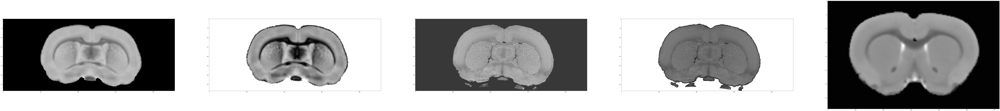

In [13]:
fig, axs = plt.subplots(ncols=5,figsize=(200,30));
axs[0].imshow(sigma.registration[:, 400, :], cmap = 'gray')
axs[1].imshow(sigma_inv.registration[:, 400, :], cmap = 'gray')
axs[2].imshow(whs.registration[:, 400, :], cmap = 'gray')
axs[3].imshow(whs_inv.registration[:, 400, :], cmap = 'gray')
axs[4].imshow(schwarz.registration[:, 400, :], cmap = 'gray')

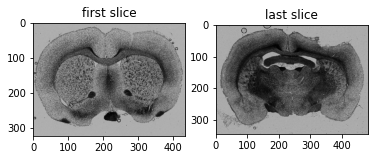

In [14]:
tiff_files = sorted(glob(slice_directory + "/*.tif*"))
assert len(tiff_files) >= 2, "there are not two tiff files in slice_directory"

# load data, pick first/last slices
first = ndimage.rotate(tif.imread(tiff_files[0]),slice_rotation) # channel 0 of first tiff
last = ndimage.rotate(tif.imread(tiff_files[-1]),slice_rotation) # channel 0 of last tiff

# plot first and last slice
fig, (ax1, ax2) = plt.subplots(ncols=2);
ax1.imshow(first[::10,::10], cmap='gray');
ax1.set_title('first slice');
ax2.imshow(last[::10,::10], cmap='gray');
ax2.set_title('last slice');

In [15]:
datetime.now().strftime("%H:%M:%S")

'16:10:04'

# Pick atlas

<span style="color:red">
which image looks most like your slices? 
*pay extra attention to hippocampal features, ventricles that are bright or dark* </span>

In [16]:
atl_list = [sigma.registration,whs.registration,sigma_inv.registration,whs_inv.registration,schwarz.registration]
atl_name_list = [sigma.name,whs.name,sigma_inv.name,whs_inv.name,schwarz.name]
plot_for_user(len(atl_list),2,[first],[400],atl_list);

In [17]:
atl = use_user_input(4,atl_list) ## change 0,1,2.. depending on which looks best above
atlas_name = use_user_input(4,atl_name_list) ## change 0,1,2.. depending on which looks best above

In [18]:
datetime.now().strftime("%H:%M:%S")

'16:10:04'

# Pick first slice

In [19]:
datetime.now().strftime("%H:%M:%S")

'16:10:04'

In [20]:
slclist=[]

for i in np.arange(0,10):
    slclist.append(int(np.shape(atl)[1]/11*i)+50)
plot_for_user(10,2,[first],slclist,[atl]);

In [21]:
bestslice = use_user_input(4,slclist)
print(bestslice)

468


### Repeat process with smaller increments closer to the real slice location

In [22]:
slclist=[]
for i in np.arange(0,12):
    slclist.append(int(bestslice)+(10*(i-5)))
plot_for_user(12,2,[first],slclist,[atl])

In [23]:
bestslice = use_user_input(2,slclist)
print(bestslice)

438


### repeat process with smaller increments closer to the real slice location
*hint* if you're struggling, scroll through quickly first and try to notice features that change a lot between the first and last option. Focus on those.

In [24]:
slclist=[]
for i in np.arange(0,12):
    slclist.append(int(bestslice+(2*(i-5))))
plot_for_user(12,2,[first],slclist,[atl])

In [25]:
bestslice = use_user_input(4,slclist)
first_slc=bestslice
print(first_slc)

436


In [26]:
datetime.now().strftime("%H:%M:%S")

'16:10:04'

# Pick last slice

In [27]:
slclist=[]
for i in np.arange(0,10):
    slclist.append((int(np.shape(atl)[1]/11)*i)+50)
plot_for_user(10,2,[last],slclist,[atl])

In [28]:
bestslice = use_user_input(4,slclist)
print(bestslice)

466


### Repeat process with smaller increments closer to the real slice location

In [29]:
datetime.now().strftime("%H:%M:%S")

'16:10:04'

In [30]:
slclist=[]
for i in np.arange(0,12):
    slclist.append(int(bestslice)+(10*(i-5)))
plot_for_user(12,2,[last],slclist,[atl])

In [31]:
bestslice = use_user_input(9,slclist)
print(bestslice)

506


### Repeat process with smaller increments closer to the real slice location

In [32]:
datetime.now().strftime("%H:%M:%S")

'16:10:04'

In [33]:
slclist=[]
for i in np.arange(0,12):
    slclist.append(int(bestslice+(2*(i-5))))
plot_for_user(12,2,[last],slclist,[atl])

In [34]:
bestslice = use_user_input(4,slclist)
last_slc=bestslice
print(last_slc)

504


In [35]:
datetime.now().strftime("%H:%M:%S")

'16:10:04'

# Make montage of all slices and equivalents

In [36]:
# warning, this is a slow step. Please be patient!
frc = (last_slc-first_slc)/len(tiff_files)
slclist=[]
tiflist = []

for i in np.arange(len(tiff_files)):
    xx=int(first_slc+(frc*i))
    slclist.append(xx)
    print
    tifin=tif.imread(tiff_files[i])
    tiflist.append(ndimage.rotate(tifin,slice_rotation))

plot_for_user(len(tiff_files),2,tiflist,slclist,[atl])

In [37]:
datetime.now().strftime("%H:%M:%S")

'16:11:06'

# If that looks reasonable, now check slice angles
Emily has pre-computed Brody lab atlas volumes at various common slice angles as the rotation of matrices is slow.
If you add an atlas and need to pre-compute these volumes, Emily included a `rotate_and_save` function. An example call of this function below:

In [38]:
 #example call of rotate_and_save: suuuuper slow.
#datetime.now().strftime("%H:%M:%S")
#atlas = schwarz
#rotate_and_save(atlas.registration,atlas.name,'m2',-2,(0,1))
#print("done with 1/8 at {} ".format(datetime.now().strftime("%H:%M:%S")))
#rotate_and_save(atlas.registration,atlas.name,'m5',-5,(0,1))
#print("done with 2/8 at {} ".format(datetime.now().strftime("%H:%M:%S")))
#rotate_and_save(atlas.registration,atlas.name,'m8',-8,(0,1))
#print("done with 3/8 at {} ".format(datetime.now().strftime("%H:%M:%S")))
#rotate_and_save(atlas.registration,atlas.name,'m10',-10,(0,1))
#print("done with 4/8 at {} ".format(datetime.now().strftime("%H:%M:%S")))
#rotate_and_save(atlas.registration,atlas.name,'p2',2,(0,1))
#print("done with 5/8 at {} ".format(datetime.now().strftime("%H:%M:%S")))
#rotate_and_save(atlas.registration,atlas.name,'p5',5,(0,1))
#print("done with 6/8 at {} ".format(datetime.now().strftime("%H:%M:%S")))
#rotate_and_save(atlas.registration,atlas.name,'p8',8,(0,1))
#print("done with 7/8 at {} ".format(datetime.now().strftime("%H:%M:%S")))
#rotate_and_save(atlas.registration,atlas.name,'p10',10,(0,1))
#print("done with 8/8 at {} ".format(datetime.now().strftime("%H:%M:%S")))##

In [39]:
datetime.now().strftime("%H:%M:%S")
# load precomputed volumes
m2 = np.load(os.path.join(atlas_directory,"{}_{}.npy".format(atlas_name,'m2')))
m5= np.load(os.path.join(atlas_directory,"{}_{}.npy".format(atlas_name,'m5')))
m8= np.load(os.path.join(atlas_directory,"{}_{}.npy".format(atlas_name,'m8')))
m10= np.load(os.path.join(atlas_directory,"{}_{}.npy".format(atlas_name,'m10')))
p2 = np.load(os.path.join(atlas_directory,"{}_{}.npy".format(atlas_name,'p2')))
p5=np.load(os.path.join(atlas_directory,"{}_{}.npy".format(atlas_name,'p5')))
p8=np.load(os.path.join(atlas_directory,"{}_{}.npy".format(atlas_name,'p8')))
p10=np.load(os.path.join(atlas_directory,"{}_{}.npy".format(atlas_name,'p10')))

# generate variables based on imported volumes
slc=last_slc
shp = np.shape(atl)[1]
frc=slc/shp

shp2=np.shape(m2)[1]
shp5=np.shape(m5)[1]
shp8 = np.shape(m8)[1]
shp10=np.shape(m10)[1]

resliced_vol_list=[m10,m8,m5,m2,atl,p2,p5,p8,p10]
shape_list = [shp10,shp8,shp5,shp2,slc,shp2,shp5,shp8,shp10]
name_list = ['m10','m8','m5','m2','zero','p2','p5','p8','p10']
angled_val_list = [-10,-8,-5,-2,0,2,5,8,10]

assert len(resliced_vol_list)==len(shape_list), "oops resliced_vol_list and shape_list aren't equal in length! please fix"
print("if there were no warnings, you're ready to plot!")

if there were no warnings, you're ready to plot!


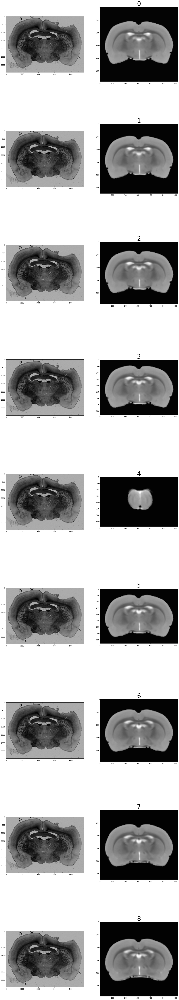

In [40]:
fig, axs = plt.subplots(len(resliced_vol_list),2,figsize=(20,120))

for i in np.arange(0,len(resliced_vol_list)):
    axs[i,1].imshow(resliced_vol_list[i][:,int(frc*shape_list[i]),:],cmap='gray')
    axs[i,1].title.set_text(str(i))
    axs[i,1].title.set_size(40)
    axs[i,0].imshow(last,cmap='gray')

In [41]:
#which volume is closest? change user_input value!

user_input =3

best_vol = use_user_input(user_input,resliced_vol_list)
best_vol_shp = shape_list[user_input]
angled_vol_name = name_list[user_input]
angled_val = angled_val_list[user_input]
print("the volume you chose is at angle {} where m= negative and p=positive".format(angled_vol_name))

the volume you chose is at angle m2 where m= negative and p=positive


In [42]:
datetime.now().strftime("%H:%M:%S")

'16:11:19'

# Check final slice with slice angle

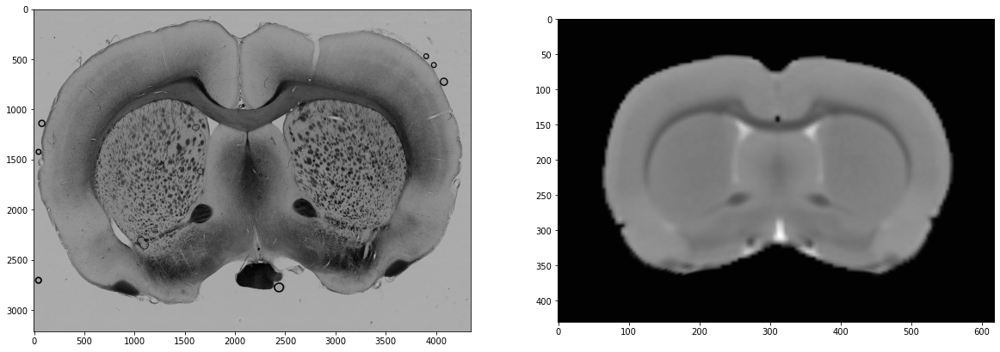

In [43]:
frc=first_slc/shp
fig, axs = plt.subplots(1,2,figsize=(20,120));
axs[0].imshow(first,cmap='gray')
axs[1].imshow(best_vol[:,int(frc*best_vol_shp),:],cmap='gray')

# Now align each slice to its best match with SimpleElastix

In [60]:
resultlist=[]
# run Elastix - warning, this is the slowest step!! Please be very patient. It takes about 3 minutes per slice on my laptop.

for i in np.arange(0,len(tiflist)):
    print("starting {} of {} at {}".format(i,len(tiflist)-1,datetime.now().strftime("%H:%M:%S")))
    frc = slclist[i]/shp
    sitk_result, transformmap = align_slice_to_atl(best_vol[:,int(frc*best_vol_shp),:],tiflist[i])
    result = sitk.GetArrayFromImage(sitk_result)
    resultlist.append(result)
    # don't want to save the new individual tiffs? comment out the following line:
    tif.imsave(os.path.join(save_directory,'aligned_{}.tif'.format(str(i))),result)
    print("aligned {} of {}".format(i,len(tiflist)-1))

starting 0 of 23 at 16:33:09
aligned 0 of 23
starting 1 of 23 at 16:33:20
aligned 1 of 23
starting 2 of 23 at 16:33:30
aligned 2 of 23
starting 3 of 23 at 16:33:40
aligned 3 of 23
starting 4 of 23 at 16:33:51
aligned 4 of 23
starting 5 of 23 at 16:34:02
aligned 5 of 23
starting 6 of 23 at 16:34:12
aligned 6 of 23
starting 7 of 23 at 16:34:23
aligned 7 of 23
starting 8 of 23 at 16:34:33
aligned 8 of 23
starting 9 of 23 at 16:34:44
aligned 9 of 23
starting 10 of 23 at 16:34:54
aligned 10 of 23
starting 11 of 23 at 16:35:05
aligned 11 of 23
starting 12 of 23 at 16:35:15
aligned 12 of 23
starting 13 of 23 at 16:35:26
aligned 13 of 23
starting 14 of 23 at 16:35:36
aligned 14 of 23
starting 15 of 23 at 16:35:46
aligned 15 of 23
starting 16 of 23 at 16:35:56
aligned 16 of 23
starting 17 of 23 at 16:36:07
aligned 17 of 23
starting 18 of 23 at 16:36:17
aligned 18 of 23
starting 19 of 23 at 16:36:28
aligned 19 of 23
starting 20 of 23 at 16:36:39
aligned 20 of 23
starting 21 of 23 at 16:36:49
ali

In [61]:
# Plot the results
# HAVING ISSUES? See list of tips in next cell!
fig, axs = plt.subplots(len(tiflist),3,figsize=(50,400));

for i in np.arange(0,len(tiflist)):
    frc = slclist[i]/shp
    axs[i,0].imshow(best_vol[:,int(frc*best_vol_shp),:],'gray')
    axs[i,1].imshow(tiflist[i],'gray')
    axs[i,2].imshow(resultlist[i],'gray')

## Troubleshooting alignments:

**0. Try using a different atlas** they're all in the same atlas space, so you can use the same slice numbers and angle

**1. Look at the comments in** the define functions section, where **align_slice_to_atl** is defined

**2. Mask your data** -- you can do this in python or in FIJI/ImageJ a few ways, described below

**2a.** threshold the image: `Image > Adjust > Threshold` and then adjust the sliders until your slice is red and the background isn't  then click `Apply` 
    - If the result looks patchy, you can proceed to step b.
    - If after step a your mask already looks good, great! You proceed to step c.
        - multiply this mask and your slice (`Process > Image Calculator`), save over old slice data, and re-run tiffile import (under load data section) or 
        - save masked vols in a new folder you create in slicedir called `masks`. Then uncomment the next cell to import your image as a mask.       
**2b.** Make your image binary: `Process > Binary > Make Binary` then you can use `Process > Binary > Dilate` and repeat that until your slice is all red/connected and the background is clear or only has some red dots. If there are red background dots, try `Process > Binary > Erode` and repeat until the brain slice is ~all red but the background spots are ~all gone then    
**2c.** Now that you have a good mask, you can either:
        - multiply this mask and your slice (`Process > Image Calculator`) or 
        - save masked vols in a new folder you create in slicedir called `masks`. Then uncomment the next cell to import your image as a mask. 
        

In [46]:
# import mask files, multiply, and use as new tiffs
#mask_files = sorted(glob(slice_directory + "/masks/*.tif*"))
#oldtiflist = tiflist.copy()

#tiflist = []

#for i in np.arange(0,len(oldtiflist)):
#    maskfile = tif.imread(mask_files[i])
#    if np.max(maskfile) !=1:
#        maskfile = maskfile/np.max(maskfile) #makes sure you have 0s/1s not 0s/255s which happens sometimes on import
#    tiflist.append(oldtiflist[i]*maskfile)

# Save outputs:

In [47]:
datetime.now().strftime("%H:%M:%S")

'16:12:26'

In [48]:
atl_null = np.zeros(np.shape(atl))
print('running - if your slices were at an angle, this step may take awhile - please be patient!')
for i in np.arange(0,len(slclist)):
    atl_null[:,slclist[i],:]=resultlist[i]
    
# if slices are at an angle, un-rotate
if angled_val != 0:
    atl_null = ndimage.rotate(atl_null,-angled_val)

print('done rotating! now saving')
save_loc = os.path.join(save_directory,'slices_in_atlas_space.tif')

if slice_direction == 'coronal':
    tif.imsave(save_loc,np.swapaxes(atl_null,2,0))
elif slice_direction == 'sagittal':
    tif.imsave(save_loc,np.swapaxes(atl_null,1,0))
elif slice_direction == 'axial':
    tif.imsave(save_loc,np.swapaxes(atl_null.T,2,1))
else:
    print("oops you need to define slice_direction as either 'coronal','sagittal', or 'axial'")

running - if your slices were at an angle, this step may take awhile - please be patient!


ValueError: could not broadcast input array from shape (430,618) into shape (390,618)

In [ ]:
print('done running notebook at {}!!!'.format(datetime.now().strftime("%H:%M:%S")))